In [14]:
import json
import re

def parse_instruction(instruction):
    bbox_dict = {
        idx: list(map(float, bbox.split(', '))) 
        for idx, bbox in enumerate(re.findall(r"\[(.*?)\]", instruction['context']))
    }
    
    parsed_response = {tuple(bbox_dict[int(idx)]): response for idx, response in instruction['response'].items()}
    
    return parsed_response


{(359.17, 146.17, 112.45, 213.57): 'compact, smooth, sturdy, metallic, hard',
 (339.88, 22.16, 153.88, 300.73): 'balanced, agile, warm, firm, steady',
 (471.64, 172.82, 35.92, 48.1): 'small, stable, warm, relaxed, responsive',
 (486.01, 183.31, 30.63, 34.98): 'light, firm, sleek, agile, balanced'}

In [30]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

def visualize_bboxes(image_path, instruction):
    parsed_response = parse_instruction(instruction)
    image = Image.open(image_path)

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image)

    for bbox, caption in parsed_response.items():
        x, y, width, height = bbox  
        rect = patches.Rectangle((x, y), width, height, linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        ax.text(x, y - 10, caption, fontsize=6, color='white', bbox=dict(facecolor='red', alpha=0.7))

    ax.axis('off')
    plt.show()

In [22]:
from pycocotools.coco import COCO

instructions = json.load(open('/root/workspace/tactile_llava/dataset/instructions.json'))
coco = COCO('/root/datasets/coco2017/annotations/instances_train2017.json')


loading annotations into memory...
Done (t=16.53s)
creating index...
index created!


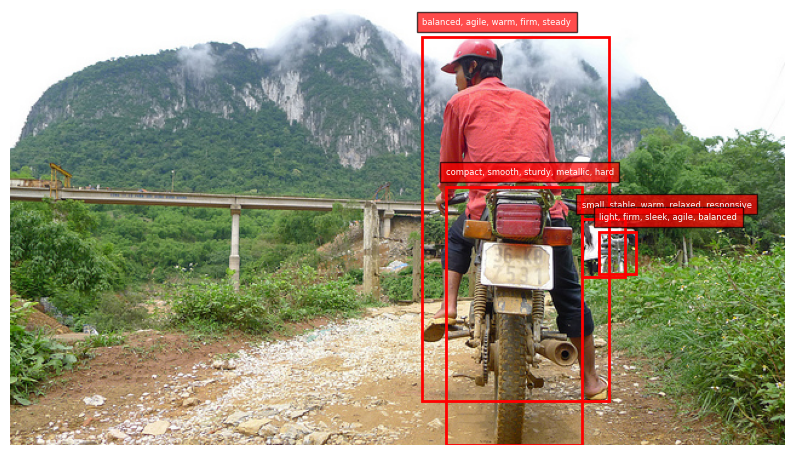

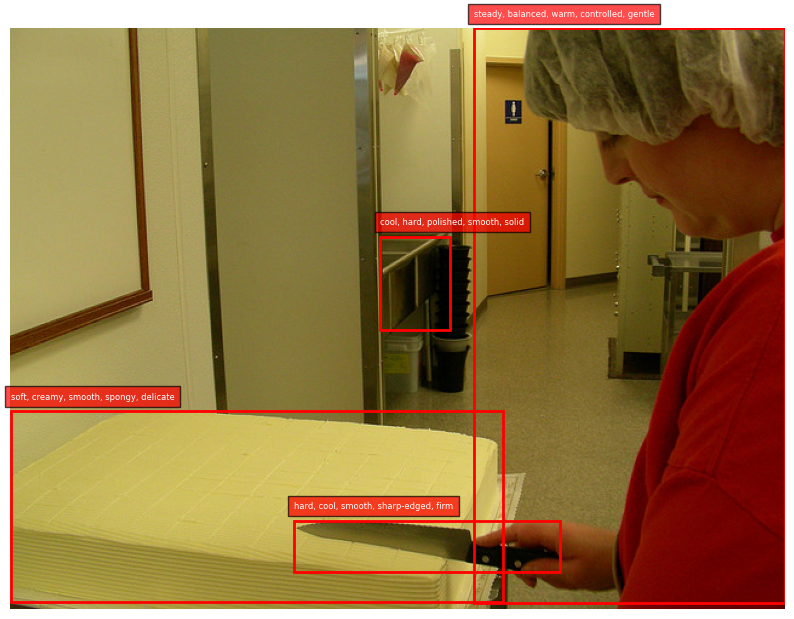

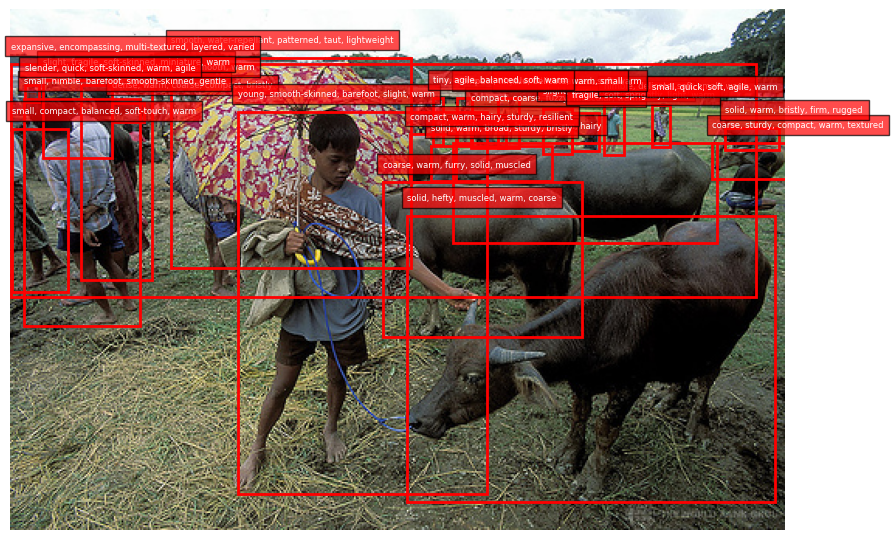

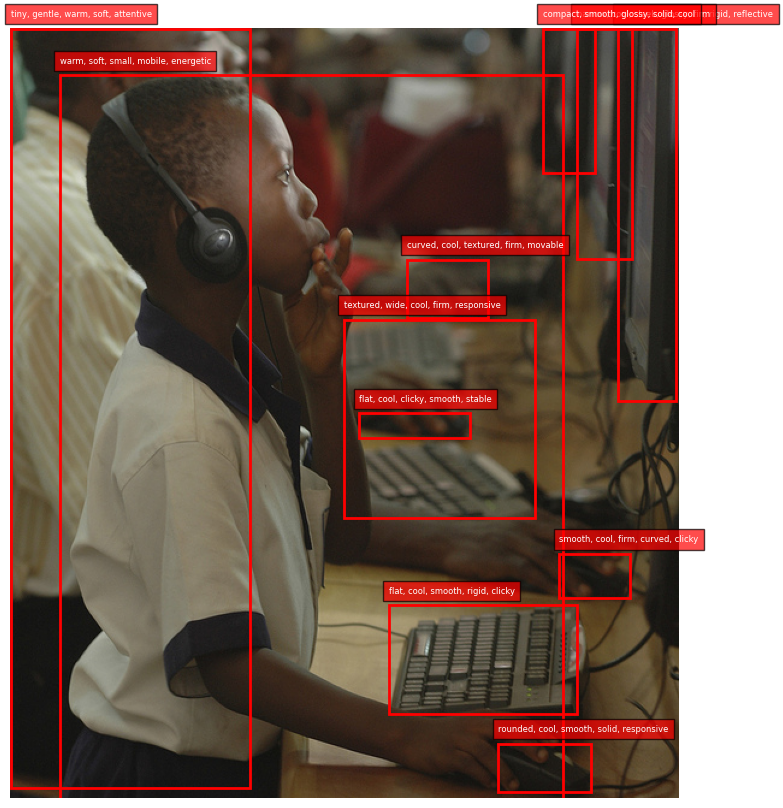

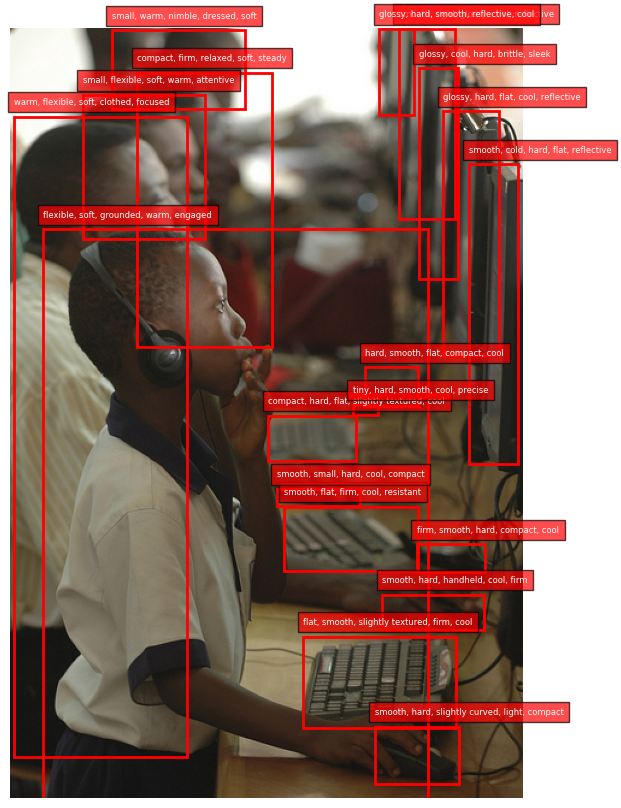

...

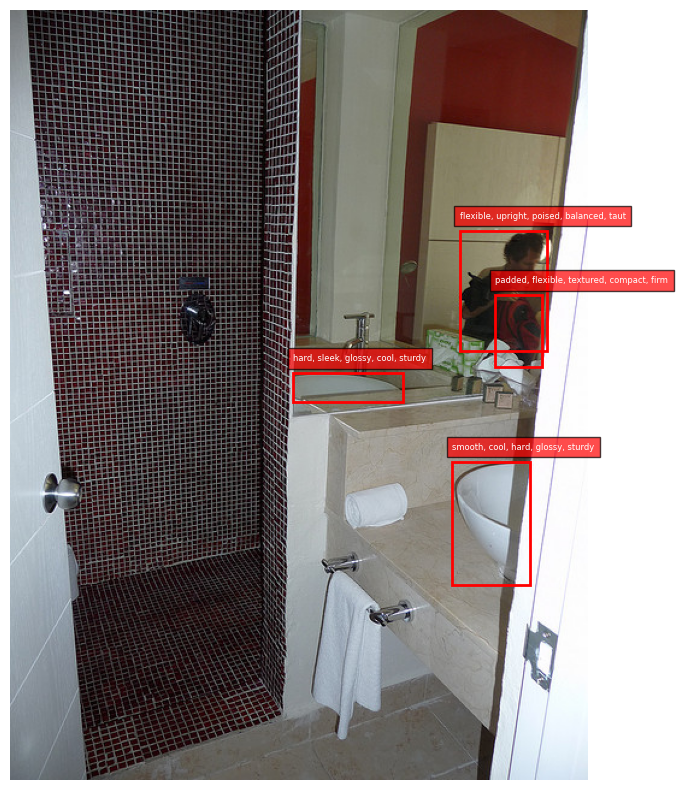

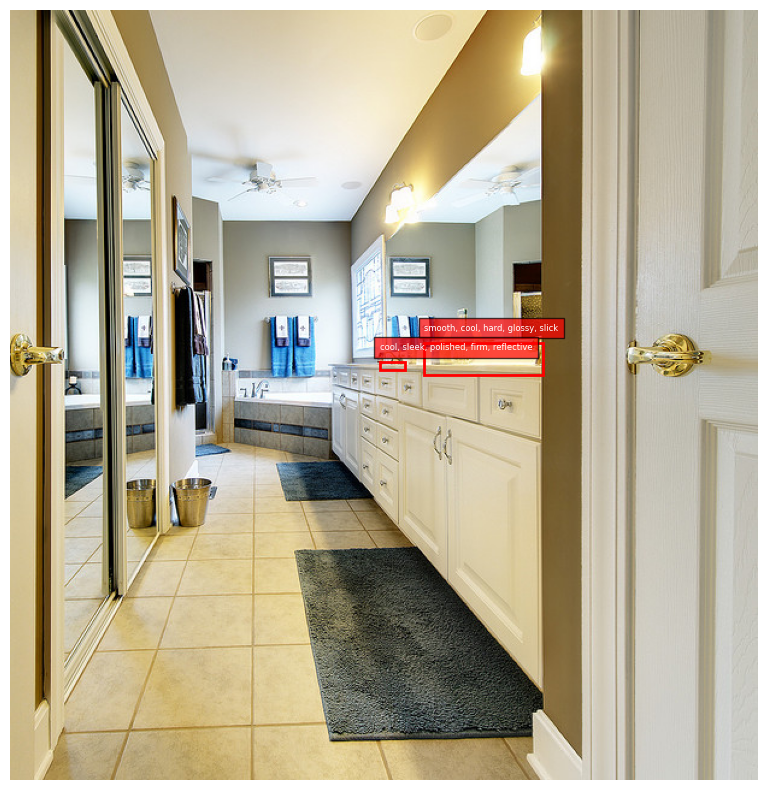

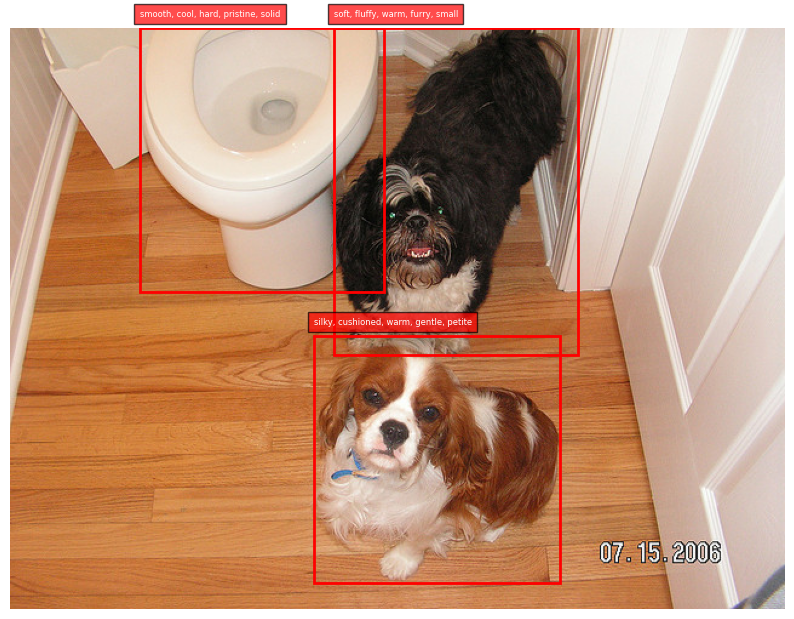

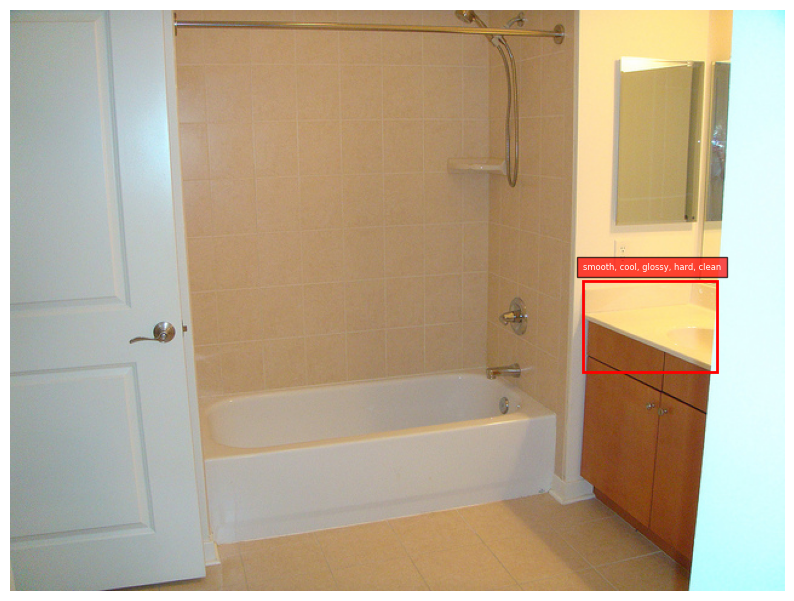

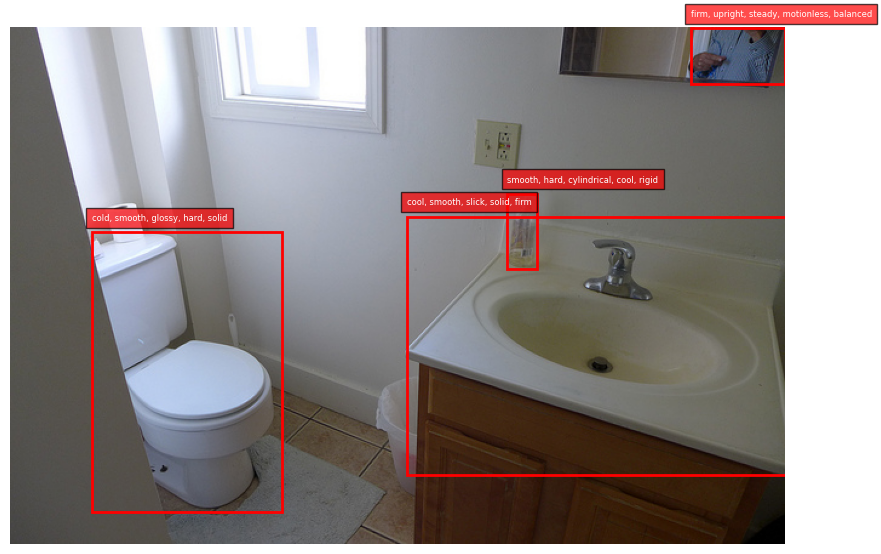

In [31]:
for img_id, instruction in instructions.items():
    img_info= coco.loadImgs(int(img_id))[0]
    image_path = f"/root/datasets/coco2017/train2017/{img_info['file_name']}"

    visualize_bboxes(image_path, instruction)